In [1]:
using DifferentialEquations, Plots, DSP
using Distributions: Gamma, pdf, Uniform

In [2]:
function lorenz(du, u, p, t)
    du[1] = 10.0(u[2] - u[1])
    du[2] = u[1] * (28. - u[3]) - u[2]
    du[3] = u[1] * u[2] - (8/3) * u[3]
end

function σ_lorenz(du, u, p, t)
    du[1] = 3.
    du[2] = 3.
    du[3] = 3.
end

σ_lorenz (generic function with 1 method)

In [3]:
prob_sde_lorenz = SDEProblem(lorenz, σ_lorenz, [1. ,0., 0.], (0., 100.))
sol = solve(prob_sde_lorenz);

In [4]:
sol.u

392195-element Vector{Vector{Float64}}:
 [1.0, 0.0, 0.0]
 [0.9882141122652579, 0.015098977179983597, 0.013204559370902733]
 [0.9994996952981539, 0.014752012889017502, 0.021594765930392893]
 [0.9940087819338383, 0.012266667668371417, 0.014565023032112556]
 [0.9910060312893109, 0.011037882095337138, 0.00935250057963489]
 [0.9846575459278402, -0.004449475773931864, 0.0042613269860105486]
 [0.9710839470322641, -0.00955509333073882, -0.0016595891196363054]
 [0.9728146788111027, -0.019197739257690923, -0.005735930532932187]
 [0.96827849812773, 0.007647614832196672, -0.025525822966662014]
 [0.9711996342767876, 0.010764631295967405, -0.02520451390680065]
 [0.9565339623885346, -0.0018111907484436043, -0.030203504846068725]
 [0.9413420429746724, 0.009030714589192745, -0.039349104516472014]
 [0.9496318054049137, 0.03302226381142854, -0.04428775218060286]
 ⋮
 [-5.176870712092224, -7.38616961822329, 20.219203572800154]
 [-5.282779971721895, -7.564152093321451, 20.209343126822567]
 [-5.2673226707043

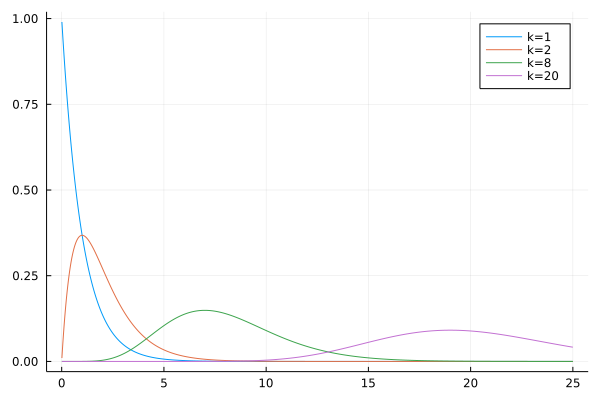

In [5]:
x = LinRange(0.01, 25, 10000)

plot(x, pdf.(Gamma(1), x), label="k=1")
plot!(x, pdf.(Gamma(2), x), label="k=2")
plot!(x, pdf.(Gamma(8), x), label="k=8")
plot!(x, pdf.(Gamma(20), x), label="k=20")

In [6]:
function hrf(x)
    peak_val= pdf(Gamma(6), x)
    undershoot_val = pdf(Gamma(12), x)
    val = peak_val - 0.35undershoot_val
    return val / 0.1727 * 0.6
end

hrf (generic function with 1 method)

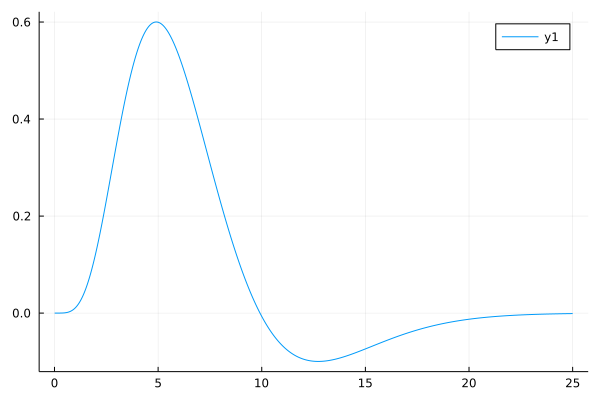

In [7]:
plot(x, hrf.(x))

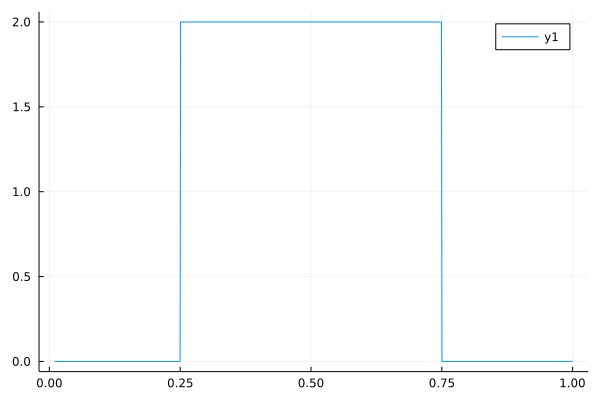

In [8]:
val = LinRange(0.01, 1., 1000)
plot(val, pdf.(Uniform(0.25, 0.75), val))

In [9]:
val_dist = pdf.(Uniform(0.25, 0.75), val)
val_hrf = hrf.(val)
val_measure = DSP.conv(val_dist, val_dist);

#plot(val, val_measure)

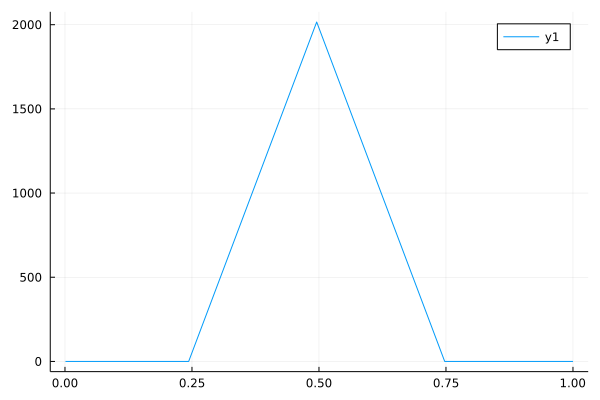

In [10]:
plot(LinRange(0.001, 1, size(val_measure)[1]), val_measure)

In [11]:
function box_grid(x, N::Int)
    res = 0.
    for n in 0:N
        res += pdf(Uniform(5+40n, 15+40n), x)
    end
    return res
end

box_grid (generic function with 1 method)

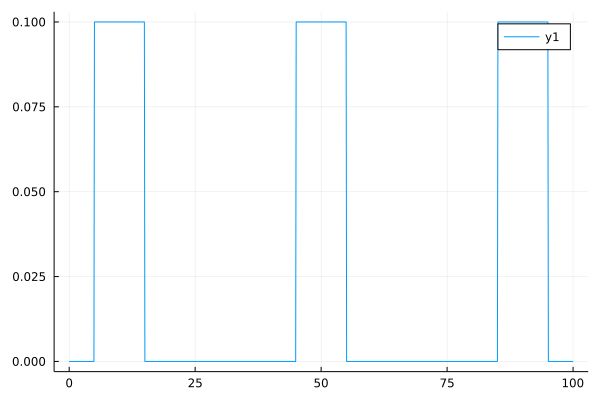

In [12]:
val = LinRange(0.01, 100., 1000)
plot(val, box_grid.(val, 10))

In [13]:
val = LinRange(0.01, 100., 10000)
val_dist = box_grid.(val, 10)
val_hrf = hrf.(val)
val_measure = DSP.conv(val_hrf, val_dist);

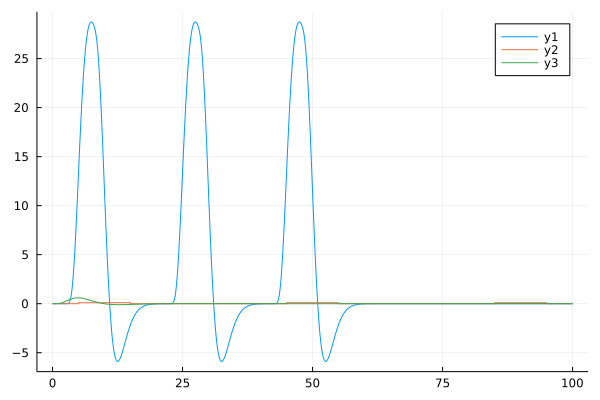

In [14]:
plot()
plot!(LinRange(0.001, 100, size(val_measure)[1]), val_measure)
plot!(val, val_dist)
plot!(val, val_hrf)

In [15]:
plot(sol, vars=(1, 2, 3))

In [16]:
sol.u

392195-element Vector{Vector{Float64}}:
 [1.0, 0.0, 0.0]
 [0.9882141122652579, 0.015098977179983597, 0.013204559370902733]
 [0.9994996952981539, 0.014752012889017502, 0.021594765930392893]
 [0.9940087819338383, 0.012266667668371417, 0.014565023032112556]
 [0.9910060312893109, 0.011037882095337138, 0.00935250057963489]
 [0.9846575459278402, -0.004449475773931864, 0.0042613269860105486]
 [0.9710839470322641, -0.00955509333073882, -0.0016595891196363054]
 [0.9728146788111027, -0.019197739257690923, -0.005735930532932187]
 [0.96827849812773, 0.007647614832196672, -0.025525822966662014]
 [0.9711996342767876, 0.010764631295967405, -0.02520451390680065]
 [0.9565339623885346, -0.0018111907484436043, -0.030203504846068725]
 [0.9413420429746724, 0.009030714589192745, -0.039349104516472014]
 [0.9496318054049137, 0.03302226381142854, -0.04428775218060286]
 ⋮
 [-5.176870712092224, -7.38616961822329, 20.219203572800154]
 [-5.282779971721895, -7.564152093321451, 20.209343126822567]
 [-5.2673226707043

In [17]:
val_measure = [DSP.conv(val_hrf, sol[i, :]) for i in 1:3]


3-element Vector{Vector{Float64}}:
 [2.5011104298755527e-12, 9.322320693172514e-11, 7.76026354287751e-10, 3.617287802626379e-9, 1.2196778698125854e-8, 3.332525011501275e-8, 7.852418093534652e-8, 1.6574358596699312e-7, 3.212974206689978e-7, 5.820074875373393e-7  …  -2.3447910280083306e-13, 2.0605739337042905e-13, -4.760636329592671e-13, 2.3447910280083306e-13, 2.5579538487363607e-13, -2.4158453015843406e-13, 1.4921397450962104e-13, 3.339550858072471e-13, 1.9184653865522705e-13, -2.5579538487363607e-13]
 [0.0, 9.094947017729282e-13, 1.8189894035458565e-12, 1.1368683772161603e-11, 5.411493475548923e-11, 1.8189894035458565e-10, 4.883986548520625e-10, 1.1323209037072957e-9, 2.3255779524333775e-9, 4.364210326457396e-9  …  3.197442310920451e-13, -8.526512829121202e-14, -7.105427357601002e-15, -3.552713678800501e-13, -6.394884621840902e-14, 2.913225216616411e-13, 2.6290081223123707e-13, -4.973799150320701e-14, 1.6342482922482304e-13, -1.8474111129762605e-13]
 [9.094947017729282e-13, -1.3642420

In [24]:
val_measure[1]

402194-element Vector{Float64}:
  2.5011104298755527e-12
  9.322320693172514e-11
  7.76026354287751e-10
  3.617287802626379e-9
  1.2196778698125854e-8
  3.332525011501275e-8
  7.852418093534652e-8
  1.6574358596699312e-7
  3.212974206689978e-7
  5.820074875373393e-7
  9.975208286050474e-7
  1.6328126548614819e-6
  2.5708338853291934e-6
  ⋮
  7.815970093361102e-14
  1.2079226507921703e-13
 -2.3447910280083306e-13
  2.0605739337042905e-13
 -4.760636329592671e-13
  2.3447910280083306e-13
  2.5579538487363607e-13
 -2.4158453015843406e-13
  1.4921397450962104e-13
  3.339550858072471e-13
  1.9184653865522705e-13
 -2.5579538487363607e-13

In [25]:
maximum(val_measure[1])

5016.256286150554

In [26]:
maximum(sol[1, :])

20.319232067270125

In [27]:
val_measure = [maximum(sol[i, :]) .* val_measure[i] ./ maximum(val_measure[i]) for i in 1:3]

3-element Vector{Vector{Float64}}:
 [1.0131189546838437e-14, 3.7761706492761453e-13, 3.143431811214508e-12, 1.4652463136422975e-11, 4.940520633377341e-11, 1.349898115565384e-10, 3.1807606396084505e-10, 6.713736688898896e-10, 1.3014719505487279e-9, 2.3575241234803782e-9  …  -9.497990200161036e-16, 8.346718660747578e-16, -1.928379828517544e-15, 9.497990200161036e-16, 1.036144385472113e-15, -9.7858080850144e-16, 6.044175581920659e-16, 1.3527440588108143e-15, 7.771082891040847e-16, -1.036144385472113e-15]
 [0.0, 3.7899375367016e-15, 7.5798750734032e-15, 4.737421920877e-14, 2.2550128343374519e-13, 7.5798750734032e-13, 2.035196457208759e-12, 4.718472233193492e-12, 9.69087028134599e-12, 1.8186015269862625e-11  …  1.3323999152466562e-15, -3.5530664406577497e-16, -2.960888700548125e-17, -1.4804443502740626e-15, -2.6647998304933128e-16, 1.2139643672247312e-15, 1.0955288192028062e-15, -2.0726220903836876e-16, 6.810044011260688e-16, -7.698310621425124e-16]
 [3.4381525861602144e-15, -5.157228879240

In [ ]:
maximum(sol[3, :])

In [28]:
p1 = plot(sol, vars=(1, 2, 3))
p2 = plot(val_measure[1], val_measure[2], val_measure[3])

plot(p1, p2, layout = (1, 2), heights=[1.5, 1.5])